### DART


#### Deepfake Analysis and Realism Test

##### Problem Statement

DeepFake is a combination of "Deep Learning" and "Fake," referring to the process of replacing someone's likeness in an image or video with someone else's using advanced technologies like Deep Artificial Neural Networks. Major companies like Google are heavily investing in countering DeepFakes, including releasing large datasets to train models that help combat this issue. This phenomenon is quickly gaining traction in the film industry and poses a significant threat to news organizations. Large digital companies, including content providers and social platforms, are at the forefront of the battle against DeepFakes. As Generative Adversarial Networks (GANs) that generate DeepFakes continue to improve, there’s potential to create a new GAN model that incorporates all the knowledge we've gathered about combating existing models, making it nearly impossible to beat by current technologies.
First we will work on detecting faces that were forged and we will work on developing a model to detect videos.

#### Deep Fake Analysis and Realism Test

###### Importing required libraries

In [1]:
!pip install -U --upgrade tensorflow

     |████████████████████████████████| 458.3MB 17kB/s s eta 0:00:01
     |████████████████████████████████| 71kB 5.3MB/s  eta 0:00:01
     |████████████████████████████████| 4.0MB 45.6MB/s eta 0:00:01
     |████████████████████████████████| 133kB 47.3MB/s eta 0:00:01
     |████████████████████████████████| 5.6MB 29.5MB/s eta 0:00:01
     |████████████████████████████████| 471kB 34.0MB/s eta 0:00:01
     |████████████████████████████████| 1.3MB 26.6MB/s eta 0:00:01
     |████████████████████████████████| 61kB 5.1MB/s  eta 0:00:01
     |████████████████████████████████| 4.6MB 24kB/s s eta 0:00:01
     |████████████████████████████████| 14.8MB 43.2MB/s eta 0:00:01
     |████████████████████████████████| 51kB 4.1MB/s  eta 0:00:01
     |████████████████████████████████| 788kB 33.0MB/s eta 0:00:01
     |████████████████████████████████| 4.9MB 28.0MB/s eta 0:00:01
  Created wheel for clang: filename=clang-5.0-cp36-none-any.whl size=30705 sha256=5e241d6fd263fae4fe98ee29e1591cc2c61754426c6d3c9

In [ ]:
# pip install tensorflow-docs==2024.2.5.73858

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [2]:
# from tensorflow_docs.vis import embed
from tensorflow import keras
#from imutils import paths

import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os

In [3]:
DATA_FOLDER = '../input/deepfake-detection-challenge'
TRAIN_SAMPLE_FOLDER = 'train_sample_videos'
TEST_FOLDER = 'test_videos'

print(f"Train samples: {len(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))}")
print(f"Test samples: {len(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))}")

Train samples: 401
Test samples: 400


In [4]:
train_sample_metadata = pd.read_json('../input/deepfake-detection-challenge/train_sample_videos/metadata.json').T
train_sample_metadata.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


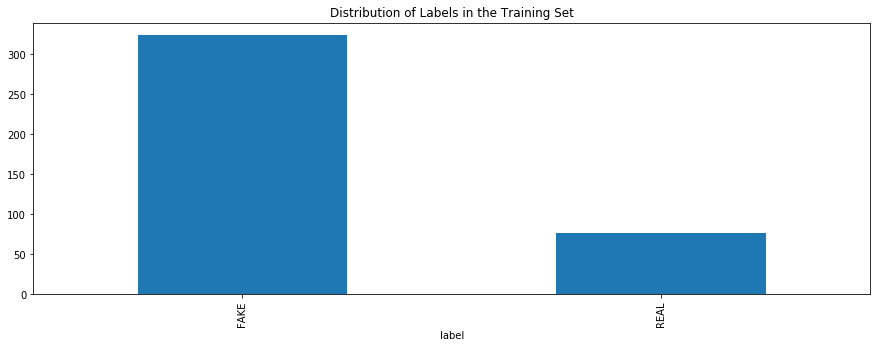

In [5]:
train_sample_metadata.groupby('label')['label'].count().plot(figsize=(15, 5), kind='bar', title='Distribution of Labels in the Training Set')
plt.show()

In [6]:
train_sample_metadata.shapew33

(400, 3)

Visualizing the data  - selecting a list of fake videos first

 some fake videos are chosen at random


In [7]:
fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].sample(10).index)
fake_train_sample_video

['azpuxunqyo.mp4',
 'dzvyfiarrq.mp4',
 'chzieimrwu.mp4',
 'cbbibzcoih.mp4',
 'cyclgfjdrv.mp4']

In [9]:
def display_image_from_video(video_path):
    '''
    input: video_path - path for video
    process:
    1. perform a video capture from the video
    2. read the image
    3. display the image
    '''
    capture_image = cv2.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

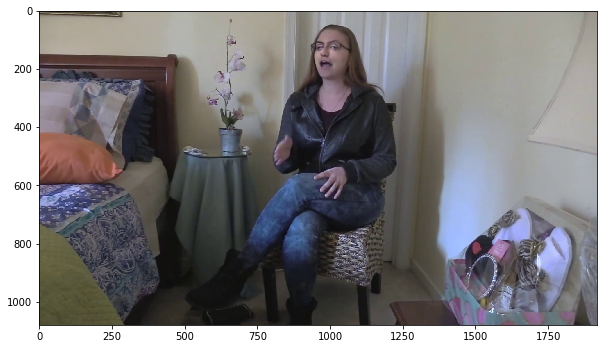

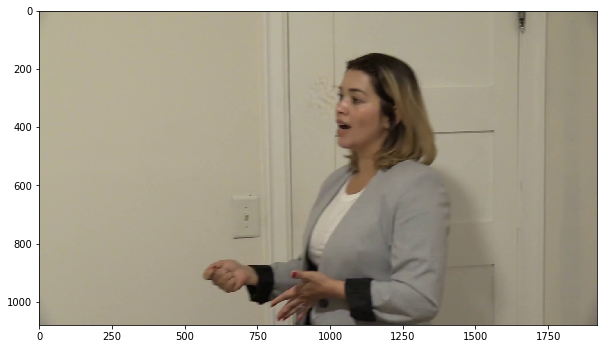

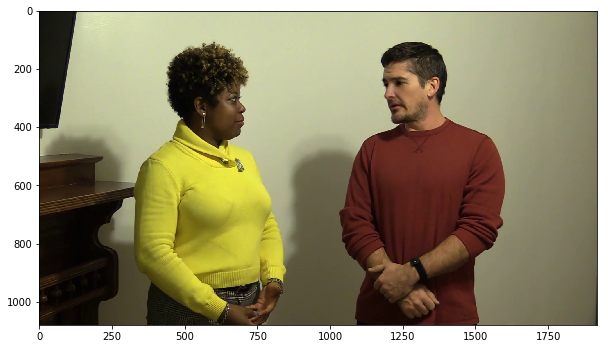

In [10]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

trying the same for few of the images that are real.

 Real Videos

In [11]:
real_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.label=='REAL'].sample(5).index)
real_train_sample_video

['efwfxwwlbw.mp4',
 'bgwmmujlmc.mp4',
 'afoovlsmtx.mp4',
 'dlpoieqvfb.mp4',
 'cfxkpiweqt.mp4']

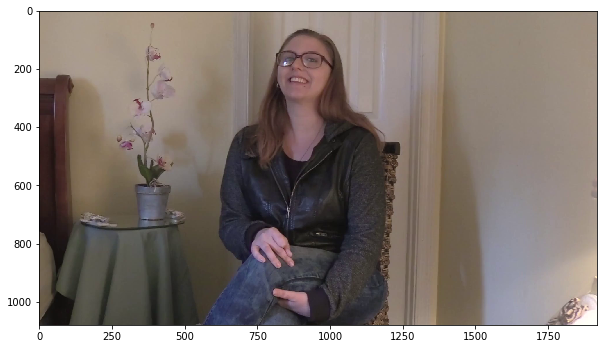

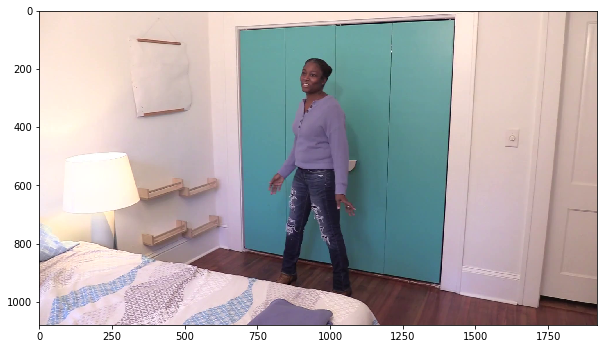

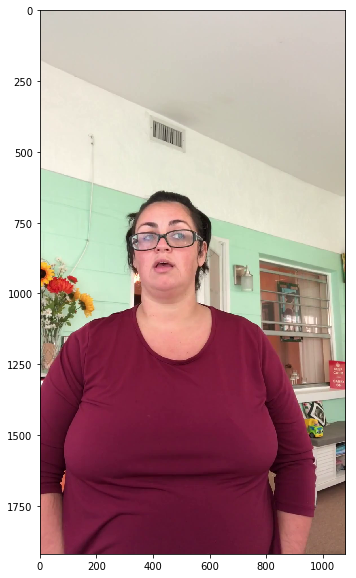

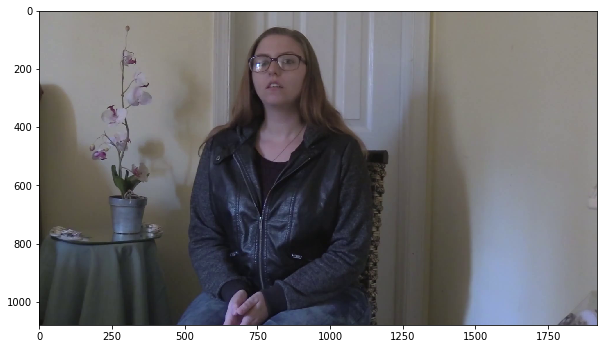

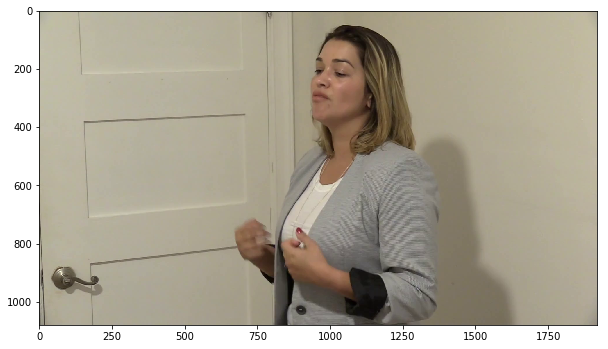

In [12]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

Videos with same original

looking at a few sample videos with the same original

In [13]:
train_sample_metadata['original'].value_counts()[0:5]

meawmsgiti.mp4    6
atvmxvwyns.mp4    6
kgbkktcjxf.mp4    5
qeumxirsme.mp4    5
qzklcjjxdq.mp4    4
Name: original, dtype: int64

 picking one of the originals with largest number of samples.

also modifying our visualization function to work with multiple images.

In [14]:
def display_image_from_video_list(video_path_list, video_folder=TRAIN_SAMPLE_FOLDER):
    '''
    input: video_path_list - path for video
    process:
    0. for each video in the video path list
        1. perform a video capture from the video
        2. read the image
        3. display the image
    '''
    plt.figure()
    fig, ax = plt.subplots(2,3,figsize=(16,8))
    # only showing images extracted from the first 6 videos
    for i, video_file in enumerate(video_path_list[0:6]):
        video_path = os.path.join(DATA_FOLDER, video_folder,video_file)
        capture_image = cv2.VideoCapture(video_path) 
        ret, frame = capture_image.read()
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        ax[i//3, i%3].imshow(frame)
        ax[i//3, i%3].set_title(f"Video: {video_file}")
        ax[i//3, i%3].axis('on')


<Figure size 432x288 with 0 Axes>

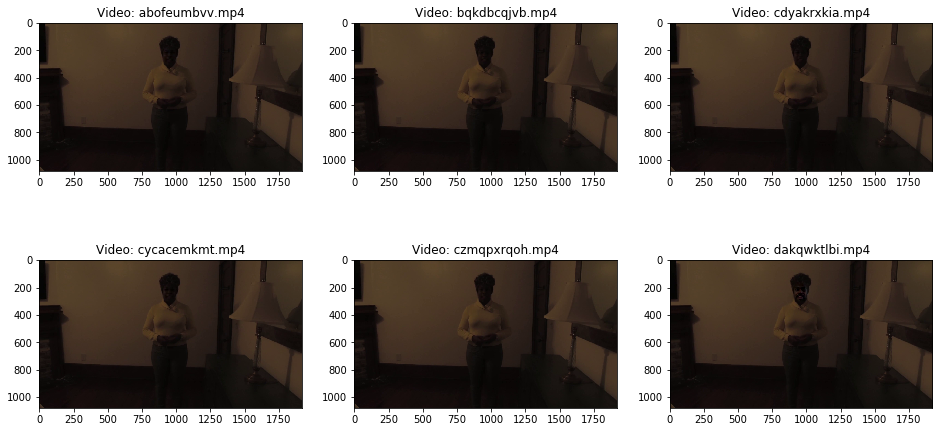

In [15]:
same_original_fake_train_sample_video = list(train_sample_metadata.loc[train_sample_metadata.original=='atvmxvwyns.mp4'].index)
display_image_from_video_list(same_original_fake_train_sample_video)

### Test video files

looking at few of the test data files.

In [16]:
test_videos = pd.DataFrame(list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER))), columns=['video'])

In [17]:
test_videos.head()

,video
0,qooxnxqqjb.mp4
1,hierggamuo.mp4
2,ocgdbrgmtq.mp4
3,icbsahlivv.mp4
4,prhmixykhr.mp4


visualizing one of the videos.

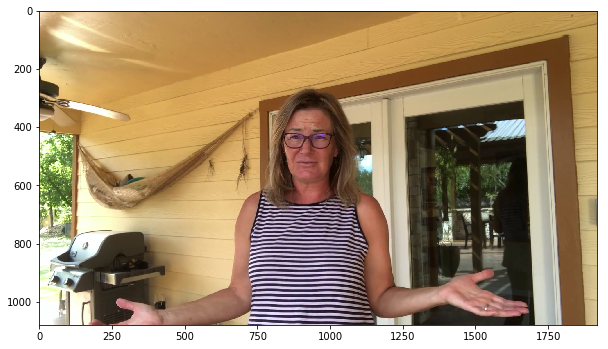

In [18]:
display_image_from_video(os.path.join(DATA_FOLDER, TEST_FOLDER, test_videos.iloc[2].video))

 Playing video files

looking at a few fake videos.

In [19]:
fake_videos = list(train_sample_metadata.loc[train_sample_metadata.label=='FAKE'].index)

In [20]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):
    
    video_url = open(os.path.join(DATA_FOLDER, subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

play_video(fake_videos[10])

from visual inspection of these fakes videos, in some cases is very easy to spot the anomalies created when building a deep fake, in some cases it is a bit more complicated .

#### Modelling

###### CNN-RNN Architecture

In [21]:
IMG_SIZE = 224
BATCH_SIZE = 32
EPOCHS = 10

MAX_SEQ_LENGTH = 20
NUM_FEATURES = 2048

 In this example i have done the following:

* Capture the frames of a video.
* Extract frames from the videos until a maximum frame count is reached.
* In the case, where a video's frame count is lesser than the maximum frame count, padding the video with zeros.

In [22]:
def crop_center_square(frame):
    y, x = frame.shape[0:2]
    min_dim = min(y, x)
    start_x = (x // 2) - (min_dim // 2)
    start_y = (y // 2) - (min_dim // 2)
    return frame[start_y : start_y + min_dim, start_x : start_x + min_dim]


def load_video(path, max_frames=0, resize=(IMG_SIZE, IMG_SIZE)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]
            frames.append(frame)

            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)

Using a pre-trained network to extract meaningful features from the extracted frames. The Keras Applications module provides a number of state-of-the-art models pre-trained on the ImageNet-1k dataset. I  have used the InceptionV3 model for the same.

In [23]:
def build_feature_extractor():
    feature_extractor = keras.applications.InceptionV3(
        weights="imagenet",
        include_top=False,
        pooling="avg",
        input_shape=(IMG_SIZE, IMG_SIZE, 3),
    )
    preprocess_input = keras.applications.inception_v3.preprocess_input

    inputs = keras.Input((IMG_SIZE, IMG_SIZE, 3))
    preprocessed = preprocess_input(inputs)

    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs, outputs, name="feature_extractor")


feature_extractor = build_feature_extractor()

87924736/87910968 [==============================] - 1s 0us/step


Finally, we can put all the pieces together to create our data processing utility.

In [24]:
def prepare_all_videos(df, root_dir):
    num_samples = len(df)
    video_paths = list(df.index)
    labels = df["label"].values
    labels = np.array(labels=='FAKE').astype(np.int)

    # `frame_masks` and `frame_features` are what i have fed to my sequence model.
    # `frame_masks`  contain a bunch of booleans denoting if a timestep is masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(
        shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
    )

    # For each video.
    for idx, path in enumerate(video_paths):
        # Gathering all the frames and adding a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames[None, ...]

        # Initializing placeholders to store the masks and features of the current video.
        temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
        temp_frame_features = np.zeros(
            shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
        )

        # Extracting features from the frames of the current video.
        for i, batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)
            for j in range(length):
                temp_frame_features[i, j, :] = feature_extractor.predict(
                    batch[None, j, :]
                )
            temp_frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()

    return (frame_features, frame_masks), labels

Since we don't have test labels i have split the training data to find its performance on unseen data

In [25]:
from sklearn.model_selection import train_test_split

Train_set, Test_set = train_test_split(train_sample_metadata,test_size=0.2,random_state=42,stratify=train_sample_metadata['label'])

print(Train_set.shape, Test_set.shape )

(320, 3) (80, 3)


In [26]:
train_data, train_labels = prepare_all_videos(Train_set, "train")
test_data, test_labels = prepare_all_videos(Test_set, "test")

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame masks in train set: {train_data[1].shape}")

Frame features in train set: (320, 20, 2048)
Frame masks in train set: (320, 20)


#### The sequence model

feeding this data to a sequence model consisting of recurrent layers like GRU.

In [27]:
# frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
# mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

# # Refer to the following tutorial to understand the significance of using `mask`:
# # https://keras.io/api/layers/recurrent_layers/gru/
# x = keras.layers.GRU(16, return_sequences=True)(
#     frame_features_input, mask=mask_input
# )
# x = keras.layers.GRU(8)(x)
# x = keras.layers.Dropout(0.4)(x)
# x = keras.layers.Dense(8, activation="relu")(x)
# output = keras.layers.Dense(1, activation="sigmoid")(x)

# model = keras.Model([frame_features_input, mask_input], output)

# model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])
# model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 20, 2048)]   0                                            
__________________________________________________________________________________________________
input_4 (InputLayer)            [(None, 20)]         0                                            
__________________________________________________________________________________________________
gru (GRU)                       (None, 20, 16)       99168       input_3[0][0]                    
                                                                 input_4[0][0]                    
__________________________________________________________________________________________________
gru_1 (GRU)                     (None, 8)            624         gru[0][0]                    

In [29]:
# checkpoint = keras.callbacks.ModelCheckpoint('./', save_weights_only=True, save_best_only=True)
# history = model.fit(
#         [train_data[0], train_data[1]],
#         train_labels,
#         validation_data=([test_data[0], test_data[1]],test_labels),
#         callbacks=[checkpoint],
#         epochs=EPOCHS,
#         batch_size=BATCH_SIZE
#     )

Epoch 1/10
10/10 [==============================] - 8s 336ms/step - loss: 0.6917 - accuracy: 0.7563 - val_loss: 0.6900 - val_accuracy: 0.8125
Epoch 2/10
10/10 [==============================] - 0s 34ms/step - loss: 0.6886 - accuracy: 0.8062 - val_loss: 0.6869 - val_accuracy: 0.8125
Epoch 3/10
10/10 [==============================] - 0s 32ms/step - loss: 0.6858 - accuracy: 0.8062 - val_loss: 0.6839 - val_accuracy: 0.8125
Epoch 4/10
10/10 [==============================] - 0s 33ms/step - loss: 0.6827 - accuracy: 0.8062 - val_loss: 0.6809 - val_accuracy: 0.8125
Epoch 5/10
10/10 [==============================] - 0s 32ms/step - loss: 0.6799 - accuracy: 0.8062 - val_loss: 0.6780 - val_accuracy: 0.8125
Epoch 6/10
10/10 [==============================] - 0s 32ms/step - loss: 0.6770 - accuracy: 0.8062 - val_loss: 0.6751 - val_accuracy: 0.8125
Epoch 7/10
10/10 [==============================] - 0s 33ms/step - loss: 0.6742 - accuracy: 0.8062 - val_loss: 0.6723 - val_accuracy: 0.8125
Epoch 8/10
1

In [33]:
frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")
x = keras.layers.GRU(64, return_sequences=True)(frame_features_input, mask=mask_input)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.GRU(32, return_sequences=True)(x)
x = keras.layers.BatchNormalization()(x)
x = keras.layers.GRU(16)(x)
x = keras.layers.Dropout(0.5)(x)  # Increased dropout
x = keras.layers.Dense(32, activation="relu")(x)
x = keras.layers.Dropout(0.5)(x)  # Added another dropout layer
output = keras.layers.Dense(1, activation="sigmoid")(x)

model = keras.Model([frame_features_input, mask_input], output)

# Use a lower learning rate and different optimizer
optimizer = keras.optimizers.Adam(learning_rate=1e-4)

model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
model.summary()

# Include Early Stopping to prevent overfitting
early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
checkpoint = keras.callbacks.ModelCheckpoint('./', save_weights_only=True, save_best_only=True)

history = model.fit(
    [train_data[0], train_data[1]],
    train_labels,
    validation_data=([test_data[0], test_data[1]], test_labels),
    callbacks=[checkpoint, early_stopping],
    epochs=EPOCHS,
    batch_size=16
)

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_11 (InputLayer)           [(None, 20, 2048)]   0                                            
__________________________________________________________________________________________________
input_12 (InputLayer)           [(None, 20)]         0                                            
__________________________________________________________________________________________________
gru_8 (GRU)                     (None, 20, 64)       405888      input_11[0][0]                   
                                                                 input_12[0][0]                   
__________________________________________________________________________________________________
batch_normalization_192 (BatchN (None, 20, 64)       256         gru_8[0][0]                

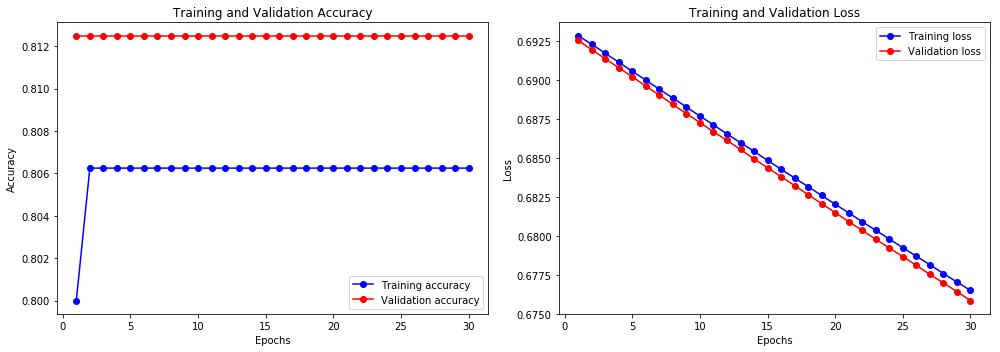

In [34]:
import matplotlib.pyplot as plt

# Extract the data from the history object
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(accuracy) + 1)

# Plot training and validation accuracy
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.plot(epochs, accuracy, 'bo-', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'ro-', label='Validation accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Plot training and validation loss
plt.subplot(1, 2, 2)
plt.plot(epochs, loss, 'bo-', label='Training loss')
plt.plot(epochs, val_loss, 'ro-', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


### Inference

In [35]:
def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_features, frame_mask

def sequence_prediction(path):
    frames = load_video(os.path.join(DATA_FOLDER, TEST_FOLDER,path))
    frame_features, frame_mask = prepare_single_video(frames)
    return model.predict([frame_features, frame_mask])[0]
    

def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=10)
    return embed.embed_file("animation.gif")


test_video = np.random.choice(test_videos["video"].values.tolist())
print(f"Test video path: {test_video}")

if(sequence_prediction(test_video)>=0.5):
    print(f'The predicted class of the video is FAKE')
else:
    print(f'The predicted class of the video is REAL')

play_video(test_video,TEST_FOLDER)

Test video path: nxgzmgzkfv.mp4
The predicted class of the video is REAL


In [ ]:
model.save('deepfake_video_model.h5')

In [32]:
# from tensorflow import keras
# import tensorflow as tf
# import pandas as pd
# import numpy as np
# import imageio
# import cv2
# import os
# import matplotlib.pyplot as plt

# DATA_FOLDER = '../input/deepfake-detection-challenge'
# TRAIN_SAMPLE_FOLDER = 'train_sample_videos'
# TEST_FOLDER = 'test_videos'

# IMG_SIZE = 224
# BATCH_SIZE = 64
# EPOCHS = 30
# MAX_SEQ_LENGTH = 20
# NUM_FEATURES = 2048

# def crop_center_square(frame):
#     y, x = frame.shape[0:2]
#     min_dim = min(y, x)
#     start_x = (x // 2) - (min_dim // 2)
#     start_y = (y // 2) - (min_dim // 2)
#     return frame[start_y : start_y + min_dim, start_x : start_x + min_dim]

# def load_video(path, max_frames=0, resize=(IMG_SIZE, IMG_SIZE)):
#     cap = cv2.VideoCapture(path)
#     frames = []
#     try:
#         while True:
#             ret, frame = cap.read()
#             if not ret:
#                 break
#             frame = crop_center_square(frame)
#             frame = cv2.resize(frame, resize)
#             frame = frame[:, :, [2, 1, 0]]
#             frames.append(frame)
#             if len(frames) == max_frames:
#                 break
#     finally:
#         cap.release()
#     return np.array(frames)

# def build_feature_extractor():
#     feature_extractor = keras.applications.InceptionV3(
#         weights="imagenet",
#         include_top=False,
#         pooling="avg",
#         input_shape=(IMG_SIZE, IMG_SIZE, 3),
#     )
#     preprocess_input = keras.applications.inception_v3.preprocess_input

#     inputs = keras.Input((IMG_SIZE, IMG_SIZE, 3))
#     preprocessed = preprocess_input(inputs)
#     outputs = feature_extractor(preprocessed)
#     return keras.Model(inputs, outputs, name="feature_extractor")

# feature_extractor = build_feature_extractor()

# def prepare_all_videos(df, root_dir):
#     num_samples = len(df)
#     video_paths = list(df.index)
#     labels = df["label"].values
#     labels = np.array(labels == 'FAKE').astype(np.int)

#     frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
#     frame_features = np.zeros(
#         shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
#     )

#     for idx, path in enumerate(video_paths):
#         frames = load_video(os.path.join(root_dir, path))
#         frames = frames[None, ...]

#         temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
#         temp_frame_features = np.zeros(
#             shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
#         )

#         for i, batch in enumerate(frames):
#             video_length = batch.shape[0]
#             length = min(MAX_SEQ_LENGTH, video_length)
#             for j in range(length):
#                 temp_frame_features[i, j, :] = feature_extractor.predict(
#                     batch[None, j, :]
#                 )
#             temp_frame_mask[i, :length] = 1

#         frame_features[idx, ] = temp_frame_features.squeeze()
#         frame_masks[idx, ] = temp_frame_mask.squeeze()

#     return (frame_features, frame_masks), labels

# from sklearn.model_selection import train_test_split

# Train_set, Test_set = train_test_split(train_sample_metadata, test_size=0.2, random_state=42, stratify=train_sample_metadata['label'])

# train_data, train_labels = prepare_all_videos(Train_set, TRAIN_SAMPLE_FOLDER)
# test_data, test_labels = prepare_all_videos(Test_set, TRAIN_SAMPLE_FOLDER)

# frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
# mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

# x = keras.layers.GRU(64, return_sequences=True)(frame_features_input, mask=mask_input)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.GRU(32, return_sequences=True)(x)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.GRU(16)(x)
# x = keras.layers.Dropout(0.5)(x)  # Increased dropout
# x = keras.layers.Dense(32, activation="relu")(x)
# x = keras.layers.Dropout(0.5)(x)  # Added another dropout layer
# output = keras.layers.Dense(1, activation="sigmoid")(x)

# model = keras.Model([frame_features_input, mask_input], output)

# # Use a lower learning rate and different optimizer
# optimizer = keras.optimizers.Adam(learning_rate=1e-4)

# model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
# model.summary()

# # Include Early Stopping to prevent overfitting
# early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
# checkpoint = keras.callbacks.ModelCheckpoint('./', save_weights_only=True, save_best_only=True)

# history = model.fit(
#     [train_data[0], train_data[1]],
#     train_labels,
#     validation_data=([test_data[0], test_data[1]], test_labels),
#     callbacks=[checkpoint, early_stopping],
#     epochs=EPOCHS,
#     batch_size=16
# )
# def prepare_single_video(frames):
#     frames = frames[None, ...]
#     frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
#     frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

#     for i, batch in enumerate(frames):
#         video_length = batch.shape[0]
#         length = min(MAX_SEQ_LENGTH, video_length)
#         for j in range(length):
#             frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
#         frame_mask[i, :length] = 1

#     return frame_features, frame_mask

# def sequence_prediction(path):
#     frames = load_video(os.path.join(DATA_FOLDER, TEST_FOLDER, path))
#     frame_features, frame_mask = prepare_single_video(frames)
#     return model.predict([frame_features, frame_mask])[0]

# test_video = np.random.choice(test_videos["video"].values.tolist())
# print(f"Test video path: {test_video}")

# if sequence_prediction(test_video) >= 0.5:
#     print(f'The predicted class of the video is FAKE')
# else:
#     print(f'The predicted class of the video is REAL')

# play_video(test_video, TEST_FOLDER)

# model.save('deepfake_video_model.h5')


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            [(None, 20, 2048)]   0                                            
__________________________________________________________________________________________________
input_10 (InputLayer)           [(None, 20)]         0                                            
__________________________________________________________________________________________________
gru_5 (GRU)                     (None, 20, 64)       405888      input_9[0][0]                    
                                                                 input_10[0][0]                   
__________________________________________________________________________________________________
batch_normalization_190 (BatchN (None, 20, 64)       256         gru_5[0][0]                